# Farmland & Crops Angle Correct
使用 [RotNet](https://github.com/d4nst/RotNet) 修正影像角度

In [1]:
import random
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

In [6]:
train = pd.read_pickle('./data/subset_train_vector_224.pkl')
train_correct = pd.read_pickle('./data/subset_train_vector_224_correct.pkl')

In [12]:
labels = train.groupby('label').count().reset_index()['label']

每個類別隨機抽選 10 張影像，比較原始影像與套用角度修正後的影像

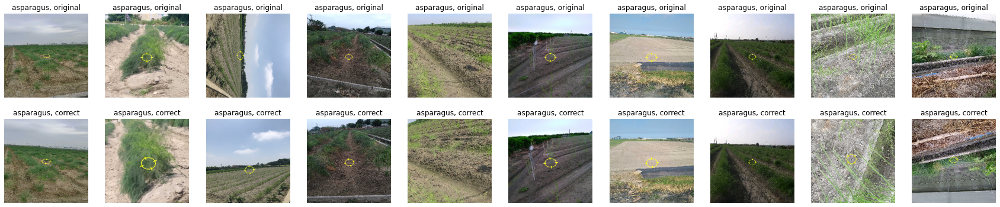

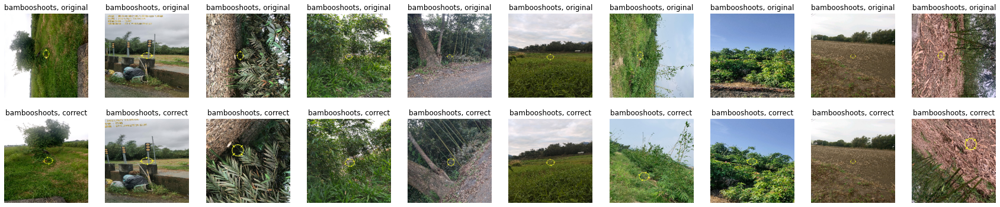

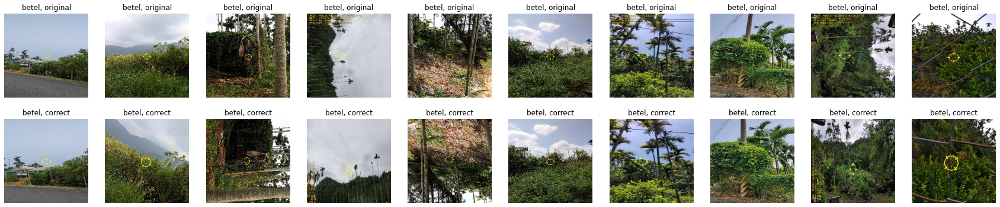

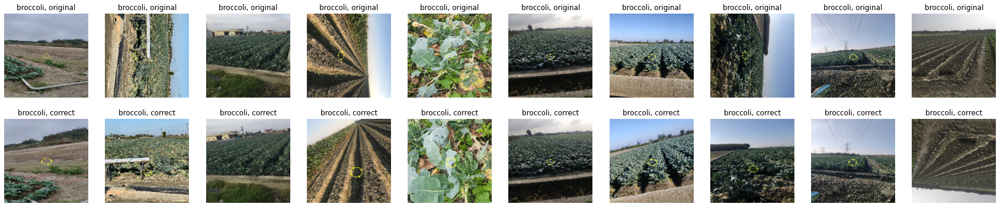

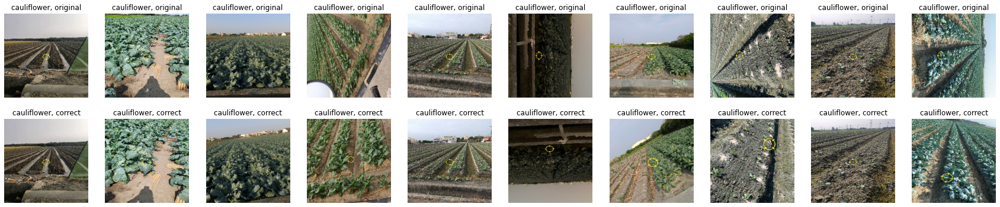

...

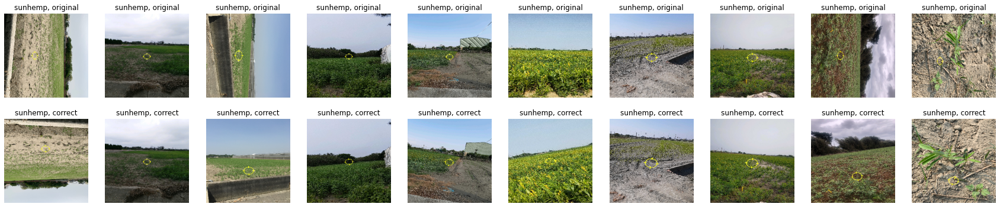

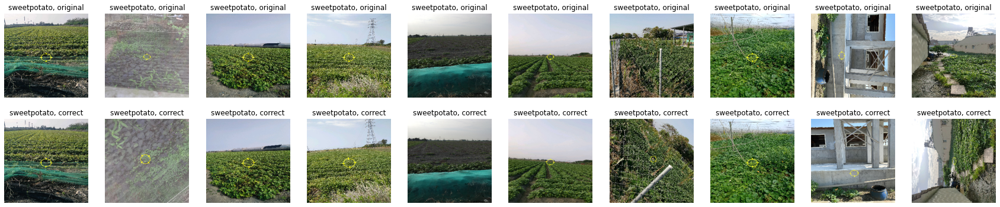

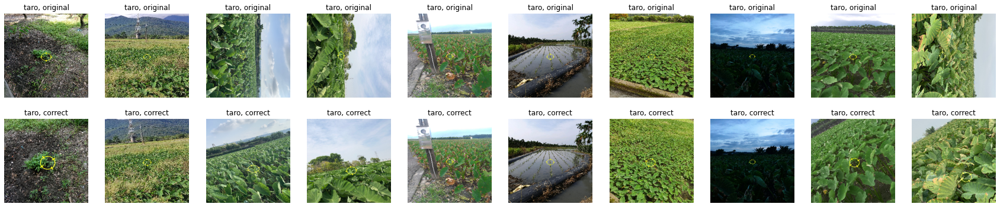

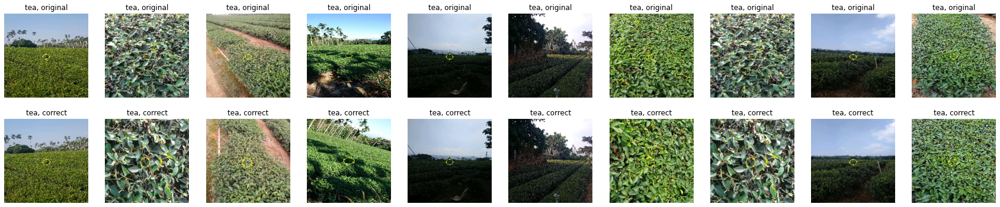

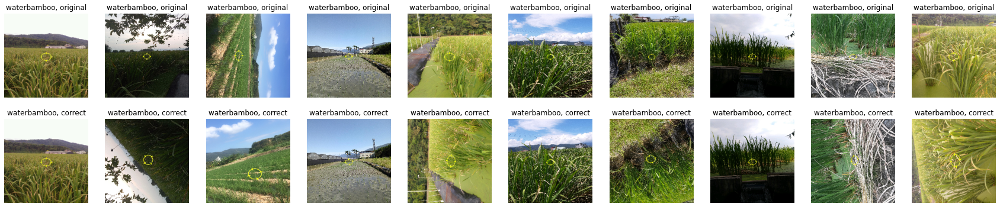

In [13]:
def row_based_idx(num_rows, num_cols, idx):
    return np.arange(1, num_rows*num_cols + 1).reshape((num_rows, num_cols)).transpose().flatten()[idx-1]

items = 10
variants = 1
df = []
for label in labels:
    plt.figure(figsize=(items * 3, variants * 6))
    for item in range(items):
        filter_by_label = train[train['label'].eq(label)].reset_index(drop=True)
        filter_by_label_correct = train_correct[train_correct['label'].eq(label)].reset_index(drop=True)
        idx = random.randint(0, len(filter_by_label)-1)
        row = filter_by_label.iloc[idx]
        row_correct = filter_by_label_correct.iloc[idx]
        df.append({'label': row['label'], 'file': row['file'], 'target_fid': row['target_fid'], 'angle': 0, 'correct': 0})
        # plot - original
        ax = plt.subplot((variants + 1), items, row_based_idx((variants + 1), items, item * (variants + 1) + 1))
        plt.imshow(np.array(row['vector'].tolist()).astype("uint8"))
        plt.title("{}, original".format(row["label"]))
        plt.axis('off')
        # plot - correct
        ax = plt.subplot((variants + 1), items, row_based_idx((variants + 1), items, item * (variants + 1) + 2))
        plt.imshow(np.array(row_correct['vector'].tolist()).astype("uint8"))
        plt.title("{}, correct".format(row["label"]))
        plt.axis('off')
    plt.show()
pd.DataFrame(df).to_csv('./sample/image_angle_correct/tag.csv', index=False)

In [11]:
result = pd.read_csv('./sample/image_angle_correct/tag.csv.csv')

原始資料有約 23% 往 90 度傾斜

In [24]:
group_by_angle = result.groupby('angle').size().reset_index(name='counts')
group_by_angle['proportion'] = round(group_by_angle['counts'] / group_by_angle['counts'].sum(), 4)
group_by_angle

,angle,counts,proportion
0,0,247,0.7485
1,90,76,0.2303
2,180,2,0.0061
3,270,5,0.0152


手工標記修正結果的時候，以每 45 度角為單位進行，總共有 8 種角度

In [25]:
group_by_correct = result.groupby('correct').size().reset_index(name='counts')
group_by_correct['proportion'] = round(group_by_correct['counts'] / group_by_correct['counts'].sum(), 4)
group_by_correct

,correct,counts,proportion
0,0,230,0.6970
1,45,13,0.0394
2,90,17,0.0515
3,135,2,0.0061
4,180,34,0.1030
5,225,1,0.0030
6,270,12,0.0364
7,315,21,0.0636


為方便與原始角度進行比較，將 8 種角度轉換縮減至 4 種

In [ ]:
correct = result.copy()
# if correct > 270 = 270
correct['correct'] = correct['correct'].apply(lambda x: 270 if x > 270 else x)
# if 270 > correct > 180 = 180
correct['correct'] = correct['correct'].apply(lambda x: 180 if (x > 180 and x < 270) else x)
# if 180 > correct > 90 = 90
correct['correct'] = correct['correct'].apply(lambda x: 90 if (x > 90 and x < 180) else x)
# if 90 > correct > 0 = 0
correct['correct'] = correct['correct'].apply(lambda x: 0 if (x > 0 and x < 90) else x)

套用角度修正模型後，往 90 度歪斜的影像減少，但往 180 度及 270 度歪斜的影像增加

In [26]:

# group
group_by_correct = correct.groupby('correct').size().reset_index(name='counts')
group_by_correct['proportion'] = round(group_by_correct['counts'] / group_by_correct['counts'].sum(), 4)
group_by_correct

,correct,counts,proportion
0,0,243,0.7364
1,90,19,0.0576
2,180,35,0.1061
3,270,33,0.1000
